In [2]:
import plotly
from plotly.offline import init_notebook_mode, iplot
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.figure_factory as ff
import seaborn as sns

init_notebook_mode(connected=True)
dataset = pd.read_csv("Kaggle Material/loan.csv", low_memory=False)

partialData = dataset


In [3]:
partialData['year'] = pd.to_datetime(partialData.issue_d).dt.year.astype(str)
partialData.sort_values('year', inplace=True)

partialData['income_category'] = np.nan

partialData.loc[(partialData['annual_inc'] <= 50000), 'income_category'] = 'Low'
partialData.loc[(partialData['annual_inc'] > 50000) & (partialData['annual_inc'] <= 80000), 'income_category'] = 'Medium'
partialData.loc[partialData['annual_inc'] > 80000, 'income_category'] = 'High'

highmask = partialData['income_category'] == 'High'
medmask = partialData['income_category'] == 'Medium'
lowmask = partialData['income_category'] == 'Low'


In [4]:
bad_loan = ["Charged Off", "Default", "Does not meet the credit policy. Status:Charged Off", "In Grace Period", 
            "Late (16-30 days)", "Late (31-120 days)"]
def loan_condition(status):
    if status in bad_loan:
        return 'Bad Loan'
    if status == 'Current':
        return 'Current'
    else :
        return 'Good Loan'
partialData['loanStat'] = partialData.loan_status.apply(loan_condition)

goodBadLoan = pd.pivot_table(partialData, values='id', index='year', columns='loanStat', aggfunc='count')

goodBadLoan['Ratio'] = goodBadLoan['Bad Loan'] / (goodBadLoan['Bad Loan'] + goodBadLoan['Good Loan'])


In [5]:
partialData.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'desc', 'purpose',
       'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'next_pymnt_d', 'last_credit_pull_d', 'collections_12_mths_ex_med',
       'mths_since_last_major_derog', 'policy_code', 'application_type',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint',
    

In [109]:
#When did they issue the good&bad loan
trace1 = go.Bar(
    x=goodBadLoan.index,
    y=goodBadLoan['Good Loan'],
    name='Good Loan',
    marker=dict(
        color='#FFD7E9'
    ),
    opacity=0.75
)

trace2 = go.Bar(
    x=goodBadLoan.index,
    y=goodBadLoan['Bad Loan'],
    name='Bad Loan',
    marker=dict(
        color='#EB89B5'
    ),
    opacity=0.75
)

trace3 = go.Scatter(
    x= goodBadLoan.index,
    y= goodBadLoan['Ratio'],
    name='Default Ratio',
    yaxis='y2'
)

data = [trace1, trace2, trace3]

layout = go.Layout(
    title='When did those Good & Bad Loan Issued',
    xaxis=dict(
        title='Value'
    ),
    yaxis=dict(
        title='Count',
    ),
    yaxis2=dict(
        title='Default Rate',
        showgrid=False,
        titlefont=dict(
            color='rgb(148, 103, 189)'
        ),
        tickfont=dict(
            color='rgb(148, 103, 189)'
        ),
        overlaying='y',
        side='right'
    ),
    bargap=0.2,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [35]:
partialData.last_pymnt_d.fillna(partialData.issue_d, inplace=True)
partialData['last_pymnt_year'] = pd.to_datetime(partialData.last_pymnt_d).dt.year.astype(str)
goodBadLastPay = partialData.pivot_table(values='id', index='last_pymnt_year', columns='loanStat', aggfunc='count').drop(columns='Current')

In [107]:
goodBadLastPay['Ratio'] = goodBadLastPay['Bad Loan'] / (goodBadLastPay['Bad Loan'] + goodBadLastPay['Good Loan'])
goodBadLastPay

loanStat,Bad Loan,Good Loan,Ratio
last_pymnt_year,,,
2007,1.0,1.0,0.500000
2008,188.0,150.0,0.556213
2009,405.0,449.0,0.474239
2010,706.0,1740.0,0.288635
2011,1227.0,4559.0,0.212064
2012,2698.0,9175.0,0.227238
2013,6554.0,20730.0,0.240214
2014,15090.0,51648.0,0.226108
2015,37942.0,125016.0,0.232833


In [111]:

trace1 = go.Bar(
    x=goodBadLastPay.index,
    y=goodBadLastPay['Good Loan'],
    name='Good Loan',
    marker=dict(
        color='#FFD7E9'
    ),
    opacity=0.75
)

trace2 = go.Bar(
    x=goodBadLastPay.index,
    y=goodBadLastPay['Bad Loan'],
    name='Bad Loan',
    marker=dict(
        color='#EB89B5'
    ),
    opacity=0.75
)

trace3 = go.Scatter(
    x= goodBadLastPay.index,
    y= goodBadLastPay['Ratio'],
    name='Default Ratio',
    yaxis='y2'
)

data = [trace1, trace2, trace3]

layout = go.Layout(
    title='Good vs Bad Loans',
    xaxis=dict(
        title='Value'
    ),
    yaxis=dict(
        title='Count',
    ),
    yaxis2=dict(
        title='Default Rate',
        showgrid=False,
        titlefont=dict(
            color='rgb(148, 103, 189)'
        ),
        tickfont=dict(
            color='rgb(148, 103, 189)'
        ),
        overlaying='y',
        side='right'
    ),
    bargap=0.2,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [8]:

trace0 = go.Box(
    y=partialData[highmask]['loan_amnt'],
    name = 'High Income',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=partialData[medmask]['loan_amnt'],
    name = 'Medium Income',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=partialData[lowmask]['loan_amnt'],
    name = 'Low Income',
    marker = dict(
        color = 'rgb(235, 152, 78)',
    )
)
data = [trace0,trace1,trace2]
iplot(data)

In [25]:
goodBadVsGrade = pd.pivot_table(partialData, index='grade', columns='loanStat', values='id', aggfunc='count').drop(columns='Current')
goodBadVsGrade['default_rate'] = goodBadVsGrade['Bad Loan'] / (goodBadVsGrade['Bad Loan'] + goodBadVsGrade['Good Loan'])

In [26]:
trace1 = go.Bar(
    x=goodBadVsGrade.index,
    y=goodBadVsGrade['Good Loan'],
    name='Good Loan'
)
trace2 = go.Bar(
    x=goodBadVsGrade.index,
    y=goodBadVsGrade['Bad Loan'],
    name='Bad Loan'
)

trace3 = go.Scatter(
    x= goodBadVsGrade.index,
    y= goodBadVsGrade.default_rate,
    name='Default Rate',
    yaxis='y2'
)

data = [trace1, trace2, trace3]
layout = go.Layout(
    title='Default Rate of Different Loan Grade',
    xaxis=dict(
        title='Loan Grade'
    ),
    yaxis=dict(
        title='Count',
    ),
    yaxis2=dict(
        title='Default Rate',
        showgrid=False,
        titlefont=dict(
            color='rgb(148, 103, 189)'
        ),
        tickfont=dict(
            color='rgb(148, 103, 189)'
        ),
        overlaying='y',
        side='right'
    ),
    barmode='group'
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [64]:
bad_loan = ["Charged Off", "Default", "Does not meet the credit policy. Status:Charged Off", "In Grace Period", 
            "Late (16-30 days)", "Late (31-120 days)"]
defaultAmt_type_year = pd.pivot_table(partialData, index='year', columns='loan_status', values='loan_amnt', aggfunc='sum')
dropList = set(partialData.loan_status).difference(set(bad_loan))
defaultAmt_type_year.drop(columns=list(dropList), inplace=True)


[4200.0,
 21250.0,
 18000.0,
 10000.0,
 16000.0,
 25975.0,
 5600.0,
 5000.0,
 15975.0,
 25000.0,
 12000.0,
 9950.0,
 20000.0,
 18000.0,
 25000.0,
 21250.0,
 8000.0,
 8000.0,
 19200.0,
 9600.0,
 15000.0,
 15000.0,
 12000.0,
 7500.0,
 29175.0,
 29175.0,
 11325.0,
 20125.0,
 30000.0,
 10900.0,
 20000.0,
 16000.0,
 16000.0,
 18000.0,
 26500.0,
 16825.0,
 26500.0,
 24925.0,
 15800.0,
 9950.0,
 20600.0,
 16000.0,
 25875.0,
 11200.0,
 12000.0,
 24925.0,
 21000.0,
 31000.0,
 4575.0,
 10400.0,
 12800.0,
 5450.0,
 20000.0,
 18000.0,
 11500.0,
 19000.0,
 35000.0,
 10300.0,
 20000.0,
 8300.0,
 11200.0,
 12000.0,
 9600.0,
 19025.0,
 5750.0,
 28100.0,
 10600.0,
 16000.0,
 25150.0,
 8000.0,
 30000.0,
 12375.0,
 30750.0,
 20000.0,
 15500.0,
 4000.0,
 23225.0,
 35000.0,
 29100.0,
 8325.0,
 16200.0,
 30000.0,
 9000.0,
 33600.0,
 28000.0,
 11700.0,
 35000.0,
 15000.0,
 20775.0,
 5375.0,
 12000.0,
 9750.0,
 12000.0,
 20000.0,
 20500.0,
 18000.0,
 12600.0,
 5000.0,
 14000.0,
 21000.0,
 14625.0,
 12000.0,
 

In [67]:

colors = ['rgba(236, 112, 99, 1)', 'rgba(235, 152, 78, 1)', 'rgba(52, 73, 94, 1)', 'rgba(128, 139, 150, 1)',
         'rgba(255, 87, 51, 1)', 'rgba(255, 195, 0, 1)']

trace1 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["Charged Off"],
    name = bad_loan[0],
    line = dict(
        color = colors[0],
        width = 3,
        dash='dash')
)

trace2 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["Default"],
    name = bad_loan[1],
    line = dict(
        color = colors[1],
        width = 3,
        dash='dash')
)

trace3 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["Does not meet the credit policy. Status:Charged Off"],
    name = 'Does not meet CP. C.Off',
    line = dict(
        color = colors[2],
        width = 3,
        dash='dash')
)

trace4 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["In Grace Period"],
    name = bad_loan[3],
    line = dict(
        color = colors[3],
        width = 3,
        dash='dash')
)

trace5 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["Late (16-30 days)"],
    name = bad_loan[4],
    line = dict(
        color = colors[4],
        width = 3,
        dash='dash')
)

trace6 = go.Scatter(
    x = defaultAmt_type_year.index,
    y = defaultAmt_type_year["Late (31-120 days)"],
    name = bad_loan[5],
    line = dict(
        color = colors[5],
        width = 3,
        dash='dash')
)

data=[trace1,trace2,trace3,trace4,trace5,trace6]

layout = dict(title = 'Types of Bad Loans <br> (Amount Borrowed Throughout the Years)',
              xaxis = dict(title = 'Year'),
              yaxis = dict(title = 'Amount Issued'),
              )

fig = dict(data=data, layout=layout)

iplot(fig)

In [9]:
partialData.income_category
scattData = partialData[['installment', 'int_rate', 'dti', 'loanStat', 'income_category']]
scattData = scattData[scattData.loanStat != 'Current']

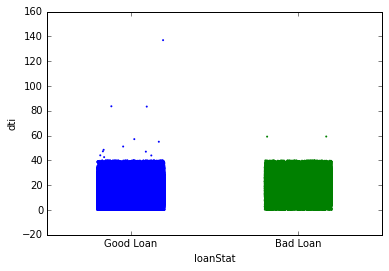

In [20]:
# sns.pairplot(scattData, hue = 'income_category', size=10, kind="reg")
# sns.jointplot(x=scattData.dti, y=scattData.int_rate, kind='kde')
sns.stripplot(scattData.loanStat, scattData.dti, jitter=0.2, size=2)

In [32]:
partialData['incomeCat'] = pd.cut(partialData.annual_inc, 3, labels=["High", "Medium", "Low"])
partialData.incomeCat.value_counts()

High      887341
Medium        20
Low           14
Name: incomeCat, dtype: int64

In [33]:
partialData.loanStat.value_counts()

Current      601779
Good Loan    218171
Bad Loan      67429
Name: loanStat, dtype: int64